In [1]:
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
import sys
import time
import datetime as dt
import pandas as pd
import geopandas as gpd
import scipy as sp
from scipy import signal
from tqdm.notebook import tqdm
import rasterio as rio
from shapely.geometry import Point, LineString, Polygon, MultiPoint
import fiona
from shapely.ops import nearest_points

In [2]:
!pwd

/Users/home/whitefar/DATA/Jupyter/REMA


In [3]:
!ls /Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/


highres_bed_channel_surveyed.npy
highres_chan_surf.npy
highres_gridded_extent.npy
highres_gridded_ice_base.npy
highres_gridded_ice_thickn.npy
highres_gridded_REMA_surf.npy
highres_gridded_x_grid.npy
highres_gridded_y_grid.npy
highres_ice_base_line2line.tif
highres_ice_thickn_channel.npy
highres_line2line_interpbydist_extent.npy
highres_line2line_interpbydist_icebase.npy
highres_line2line_interpbydist_ice_thickn.npy
highres_line2line_interpbydist_points_x.npy
highres_line2line_interpbydist_points_y.npy
highres_line2line_interpbydist_REMAsurf.npy
highres_points_x_channel.npy
highres_points_y_channel.npy
highres_surf_channel_surveyed.npy
highres_thickness_line2line.tif
ice_base_mitgcm.npy
ice_base_no_chan.pkl
ice_base_smooth_mitgcm.npy
picked_bed_metadata.csv
sea_level_below_surf_corrected.npy
smoo_ice_base_mitgcm.npy
smoo_ice_base_smooth_mitgcm.npy
smooth4_mitgcm_icebase.npy
smooth4_mitgcm_ice_thickn_channel.npy
smooth4_mitgcm_ice_thickn.npy
smooth4_mitgcm_points_x_channel.npy
smooth4_mi

In [5]:
x_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/highres_line2line_interpbydist_points_x.npy')
y_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/highres_line2line_interpbydist_points_y.npy')
# it_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/channel_line2line_interpbydist_ice_thickn.npy')
# ib_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/highres_line2line_interpbydist_icebase.npy')

In [6]:
#load REMA
nid1 = 159202
nid2 = 131226
df = gpd.read_file('/Volumes/arc_02/whitefar/DATA/REMOTE_SENSING/REMA_STRIPES/REMA_Strip_Index_Rel1/REMA_Strip_Index_Rel1.shp')

In [7]:
path = f"/Volumes/arc_02/whitefar/DATA/REMOTE_SENSING/REMA_STRIPES/DIFFERENCES/REMA_159202-131226_diff.tif"
f = df.loc[nid1].acquisitio
t =df.loc[nid2].acquisitio

In [8]:
df.loc[nid2].fileurl

'http://data.pgc.umn.edu/elev/dem/setsm/REMA/geocell/v1.0/2m/s83w153/SETSM_WV01_20161109_1020010058134D00_10200100576C9100_seg1_2m_v1.0.tar.gz'

In [9]:
duration = (pd.to_datetime(t)-pd.to_datetime(f)).days/365.25
with rio.open(path) as image:
    im = image.read(1)
    im = im / duration
#     im[im==-9999] = np.nan
    extent_REMAdiff = [image.bounds[0],image.bounds[2],image.bounds[1],image.bounds[3]]
    left = image.bounds[0]
    bottom = image.bounds[1]
    right = image.bounds[2]    
    top = image.bounds[3]
    

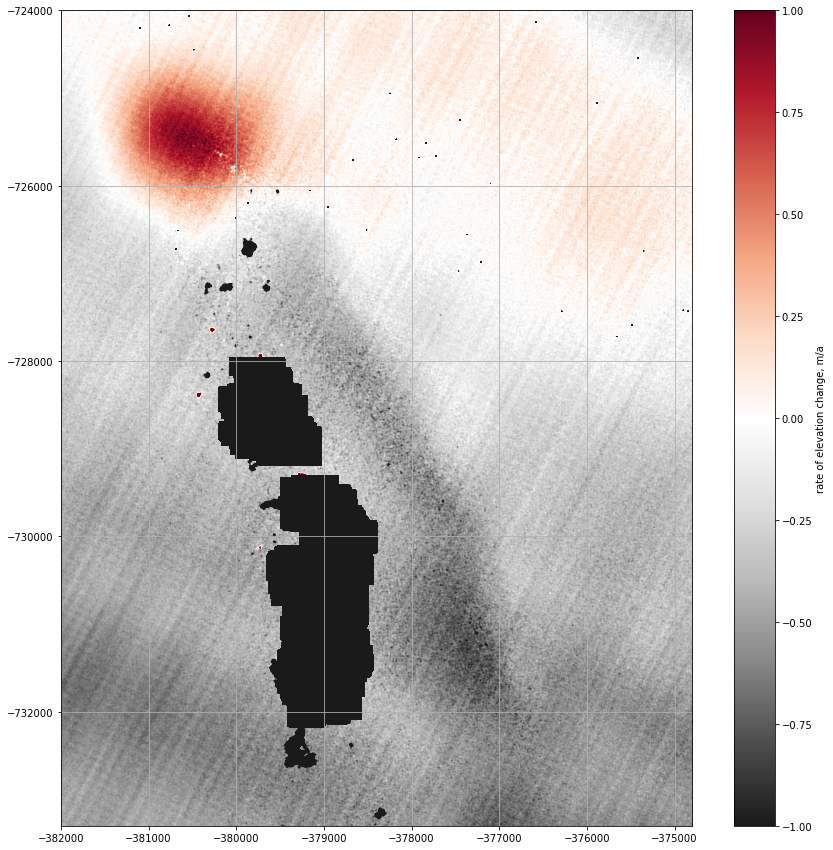

In [10]:
plt.figure(figsize=(15,15))
GyRd = plt.cm.get_cmap('RdGy').reversed()
plt.imshow(im,extent=extent_REMAdiff, vmin=-1,vmax=1,cmap=GyRd)
cb = plt.colorbar()
cb.set_label('rate of elevation change, m/a')
plt.xlim([-382000, -374800])
plt.ylim([-733300,-724000])
plt.grid()
plt.show()

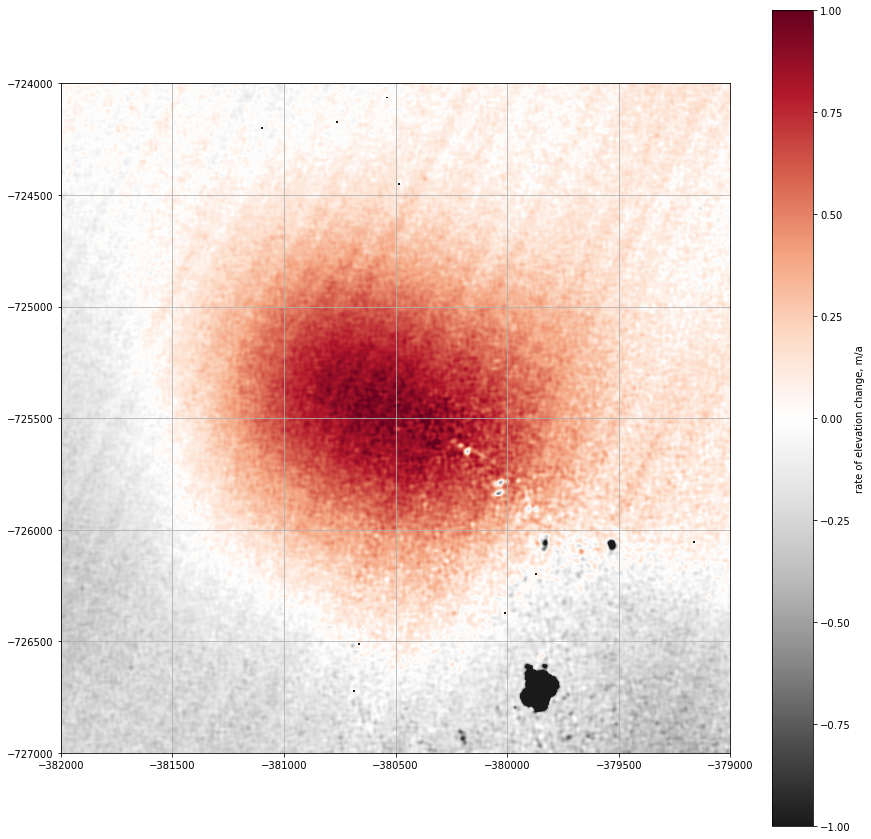

In [11]:
plt.figure(figsize=(15,15))
GyRd = plt.cm.get_cmap('RdGy').reversed()
plt.imshow(im,extent=extent_REMAdiff, vmin=-1,vmax=1,cmap=GyRd)
cb = plt.colorbar()
cb.set_label('rate of elevation change, m/a')
plt.xlim([-382000, -379000])
plt.ylim([-727000,-724000])
plt.grid()
plt.show()

convex hull

1. get xv and yv values from raster
2. make 3D array of [elevation change, xv, yv]
3. restrict array to > 0.75
4. multiply elevation change by pixel size

In [12]:
# figuring out indexing

# aa = np.array([np.arange(0,12).reshape(3,4),np.arange(0,12).reshape(3,4)+0.1,np.arange(0,12).reshape(3,4)+0.2])
# aa
# aa[:,aa[1,:]>3.1].reshape(3,2,4)

In [13]:
#1. get sv and yv values from raster
x = np.linspace(left,right, im.shape[1])
y = np.linspace(top,bottom, im.shape[0])
xv, yv = np.meshgrid(x ,y ) 
print(xv.shape,yv.shape,im.shape)

(20089, 19985) (20089, 19985) (20089, 19985)


In [14]:
# 2. make 3D array of [elevation change, xv, yv]
elevs = np.array([xv,yv,im])
elevs.shape

(3, 20089, 19985)

In [15]:
#reduce the array to elevation change above 0.7 and to the area over the bullseye
elevs_red = elevs[:,(elevs[2,:]>0.5) & (elevs[0,:]> -382000) & (elevs[0,:]<-379000) & (elevs[1,:] > -727000)  & (elevs[1,:] < -724000)] 
elevs_red_area = elevs[:,(elevs[0,:]> -382000) & (elevs[0,:]<-379000) & (elevs[1,:] > -727000)  & (elevs[1,:] < -724000)] 

In [16]:
elevs_red.shape

(3, 270567)

In [15]:
# del elevs, xv, yv, im

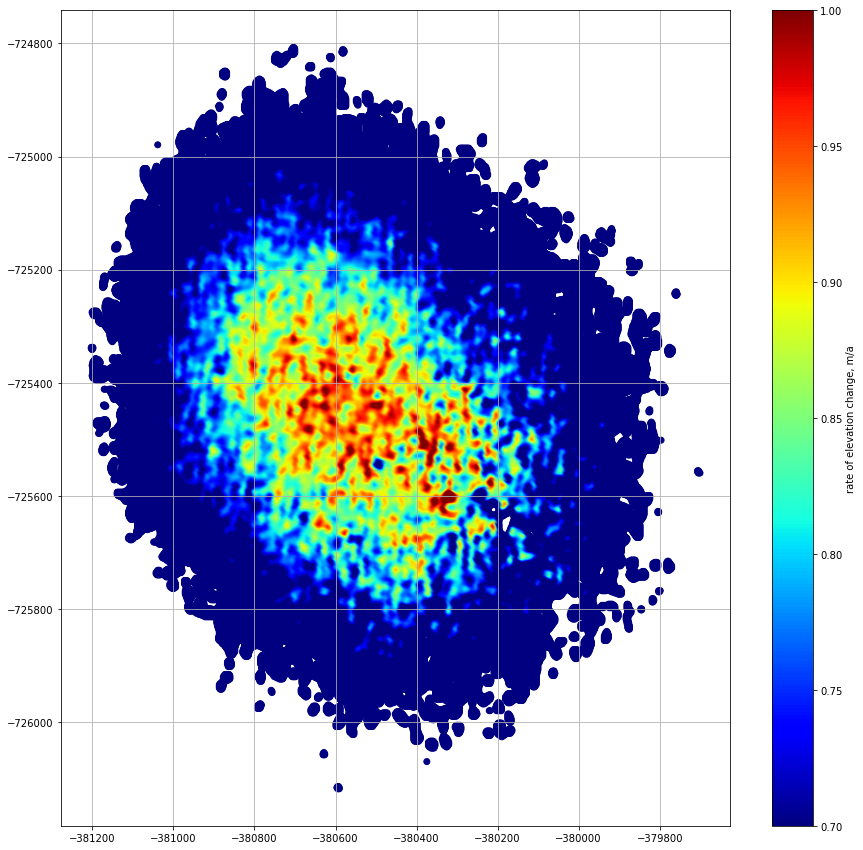

In [17]:
plt.figure(figsize=(15,15))
GyRd = plt.cm.get_cmap('RdGy').reversed()
plt.scatter(elevs_red[0,:],elevs_red[1,:],c=elevs_red[2,:],vmin=0.7,vmax=1,cmap='jet')
cb = plt.colorbar()
cb.set_label('rate of elevation change, m/a')
# plt.xlim([-382000, -374800])
# plt.ylim([-733300,-724000])
plt.grid()
plt.show()

In [20]:
print(elevs_red.max(),elevs_red.min())

1.2909752130508423 -726117.3217841497


(array([6.0290e+04, 5.6017e+04, 4.9209e+04, 4.3093e+04, 3.9396e+04,
        2.0455e+04, 1.9760e+03, 7.1000e+01, 3.2000e+01, 2.8000e+01]),
 array([0.50000048, 0.57909795, 0.65819542, 0.7372929 , 0.81639037,
        0.89548784, 0.97458532, 1.05368279, 1.13278027, 1.21187774,
        1.29097521]),
 <BarContainer object of 10 artists>)

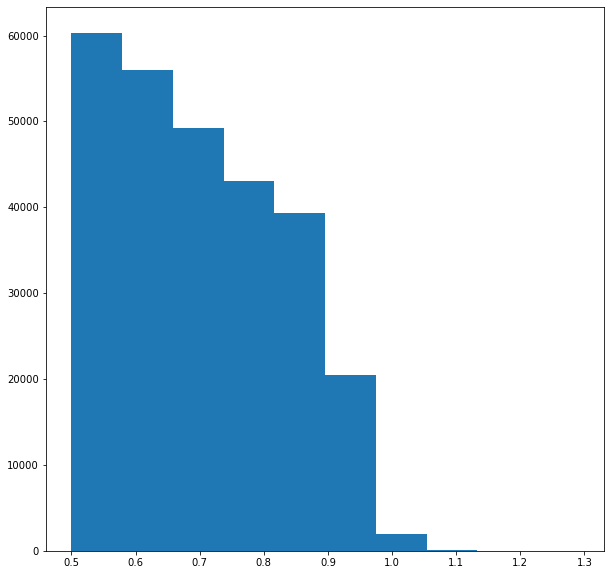

In [21]:
plt.figure(figsize=(10,10))
plt.hist(elevs_red[2,:])


(array([6.0290e+04, 5.6017e+04, 4.9209e+04, 4.3093e+04, 3.9396e+04,
        2.0455e+04, 1.9760e+03, 7.1000e+01, 3.2000e+01, 2.8000e+01]),
 array([0.50000048, 0.57909795, 0.65819542, 0.7372929 , 0.81639037,
        0.89548784, 0.97458532, 1.05368279, 1.13278027, 1.21187774,
        1.29097521]),
 <BarContainer object of 10 artists>)

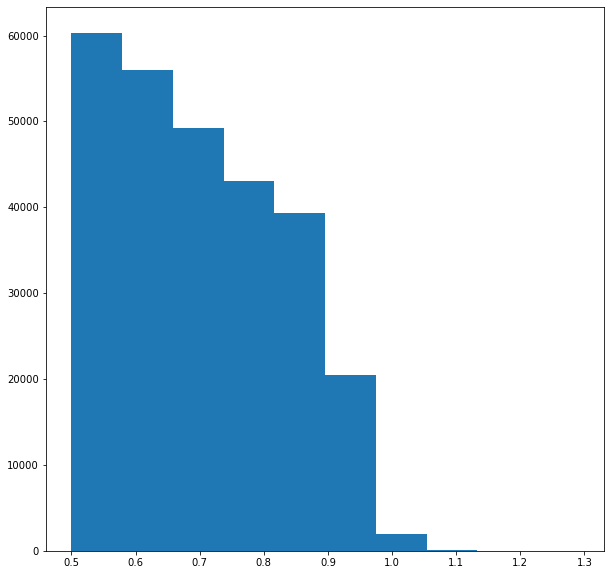

In [22]:
plt.figure(figsize=(10,10))
plt.hist(elevs_red[2,:])


(array([2.0407e+04, 1.9962e+04, 1.9921e+04, 1.9480e+04, 1.8535e+04,
        1.8002e+04, 1.7148e+04, 1.6081e+04, 1.5980e+04, 1.5258e+04,
        1.4448e+04, 1.3387e+04, 1.3074e+04, 1.3588e+04, 1.2734e+04,
        9.6490e+03, 6.7620e+03, 4.0440e+03, 1.3890e+03, 4.7100e+02,
        1.1600e+02, 4.1000e+01, 1.3000e+01, 1.7000e+01, 9.0000e+00,
        1.3000e+01, 1.0000e+01, 9.0000e+00, 1.2000e+01, 7.0000e+00]),
 array([0.50000048, 0.5263663 , 0.55273213, 0.57909795, 0.60546377,
        0.6318296 , 0.65819542, 0.68456125, 0.71092707, 0.7372929 ,
        0.76365872, 0.79002455, 0.81639037, 0.8427562 , 0.86912202,
        0.89548784, 0.92185367, 0.94821949, 0.97458532, 1.00095114,
        1.02731697, 1.05368279, 1.08004862, 1.10641444, 1.13278027,
        1.15914609, 1.18551191, 1.21187774, 1.23824356, 1.26460939,
        1.29097521]),
 <BarContainer object of 30 artists>)

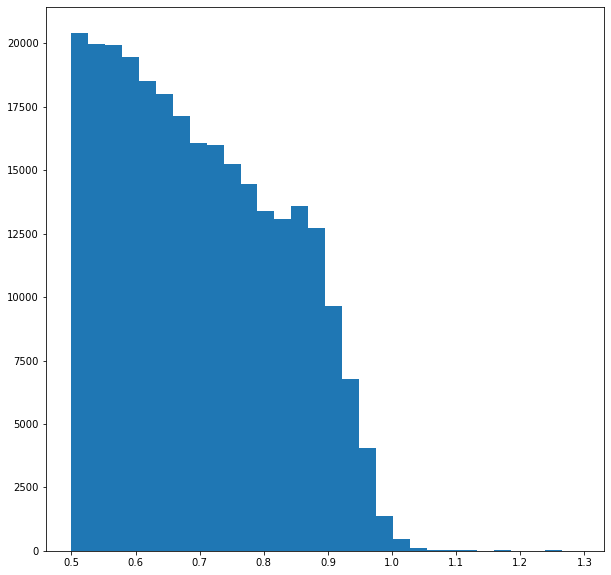

In [23]:
plt.figure(figsize=(10,10))
plt.hist(elevs_red[2,:],30)


In [24]:
print('median melt rate = ',np.median(elevs_red[2,:]))

median melt rate =  0.6876271367073059


In [25]:
print('mean melt rate = ',np.mean(elevs_red[2,:]))

mean melt rate =  0.7008259003058765


In [26]:
# 4. multiply elevation change by pixel size
mass_loss = np.sum(elevs_red[2,:])*pixel
print(mass_loss,' m^3 / a of ice downwasted')

758557.1597061481  m^3 / a of ice downwasted


### Next see how much melt would need in channel

1. make a polygon of downwasting
2. make a polygon of channel
3. get intersection
4. see downwasting rate in intersection

In [27]:
# 1. make a polygon of downwasting
bullseye_mp = MultiPoint( [(x,y) for x,y in zip(elevs_red[0,:],elevs_red[1,:])])
bullseye_mp

In [28]:
bullseye = bullseye_mp.convex_hull


In [29]:
# import pickle
# with open('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/shapefiles/bullseye.pkl', "wb") as poly_file:
#     pickle.dump(bullseye, poly_file, pickle.HIGHEST_PROTOCOL)

get all points from in the shape

In [31]:
df = pd.DataFrame({'x': elevs_red_area[0,:],
                        'y': elevs_red_area[1,:],
                        'dzdt':elevs_red_area[2,:]})

In [32]:
del elevs_red, bullseye_mp, elevs_red_area

In [33]:
geometry = [Point(xy) for xy in zip(df.x,df.y)]
gdf= gpd.GeoDataFrame(df,geometry=geometry,crs="EPSG:3031")

In [34]:
gdf['in_bullseye'] = gdf.geometry.intersects(bullseye)

In [35]:
#ThIS IS THE GOOD ONE TO USE - VOLUME DOWNWASTED
volume_loss = gdf[gdf['in_bullseye']==True].dzdt.sum()*pixel

In [36]:
volume_loss

901820.7966866544

In [37]:
bullseye.area

1416435.3794054328

In [39]:
# bullseye.area*np.mean(elevs_red[2,:])

In [40]:
# 2. make a polygon of channel
chan_right =  [(x,y) for x,y in zip(x_interpd[0,::-1],y_interpd[0,::-1])]
chan_left =  [(x,y) for x,y in zip(x_interpd[-1,:],y_interpd[-1,:])]
chan_beg = [(x,y) for x,y in zip(x_interpd[:,0],y_interpd[:,0])]
chan_end = [(x,y) for x,y in zip(x_interpd[::-1,-1],y_interpd[::-1,-1])]

In [41]:
chan = Polygon(chan_left+chan_end+chan_right+chan_beg)

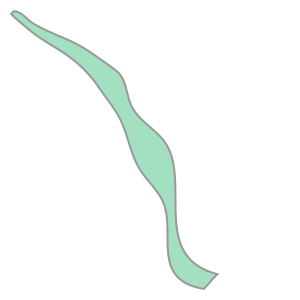

In [42]:
chan

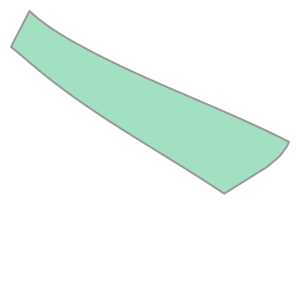

In [43]:
# 3. get intersection
melt_under = chan.intersection(bullseye)
melt_under

In [44]:
# 4. see downwasting rate in intersection

In [45]:
print("melt rate in 1D m / a underneath  = ",volume_loss / melt_under.area)

melt rate in 1D m / a underneath  =  2.182167015521581


In [36]:
X0a = Point(x_interpd[0,0],y_interpd[0,0])
X0b = Point(x_interpd[-1,0],y_interpd[-1,0])

print('width of channel is ',X0a.distance(X0b),'m')

width of channel is  105.51833963810854 m
